In [1]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

import warnings
warnings.filterwarnings("ignore")

## Чтение данных

In [2]:
data = pd.read_csv("data/data.csv")
genre_data = pd.read_csv('data/data_by_genres.csv')
year_data = pd.read_csv('data/data_by_year.csv')

In [3]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [4]:
print(genre_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB
None


In [5]:
print(year_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB
None


Посмотрим как коррелируют разные фичи с популярностью треков

<AxesSubplot:>

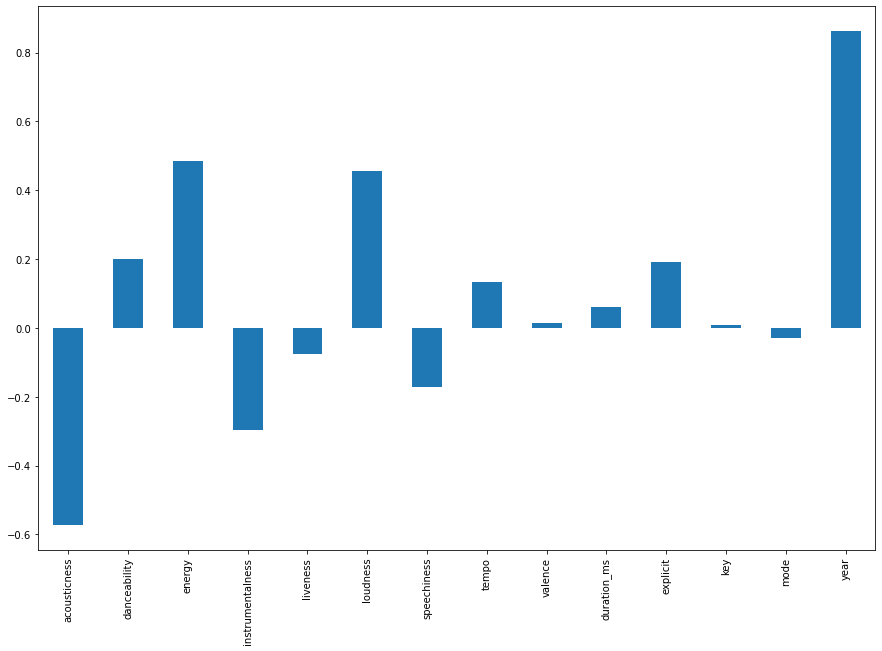

In [6]:
feature_names = ['acousticness', 
              'danceability', 
              'energy', 
              'instrumentalness', 
              'liveness', 
              'loudness', 
              'speechiness', 
              'tempo', 
              'valence',
              'duration_ms',
              'explicit',
              'key',
              'mode',
              'year']

data.corr()['popularity'][feature_names].plot(kind='bar', figsize=(15,10))

Видно, что есть фичи практически не влияющие на популярность, однако есть и значительно влияющие

## По времени

Используя данные, сгруппированные по годам, мы можем понять, как изменилось общее звучание музыки с течением времени, используя музыкальные фичи

In [7]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features)
fig.show()

Как видно, акустичность музыки с течением времени упала, можно связать с появлением цифровой музыки. В то же время энергичность выросла, что можно объяснить появлением новых различных жанров, что также обусловленно появлением электронной музыки.

## По жанрам

Можно использовать жанровый датасет, чтобы сравнить различные жанры и понять их уникальные различия в звучании.

In [8]:
top10_genres = genre_data.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

По первым 10 популярным жанрам можно увидеть, что все они различаются по основным музыкальным показателям и их можно кластеризовать, убедимся в этом:

In [9]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

In [10]:
# Визуализируем через tSNE

from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.007s...
[t-SNE] Computed neighbors for 2973 samples in 0.326s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.105049
[t-SNE] KL divergence after 1000 iterations: 1.390022


Как видно, кластеризуются жарнры хорошо, учитывая что кластеризация была по 10 кластерам, а жанров больше.

А теперь то же самое только для треков, и увеличим колво кластеров до 20:

In [11]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [12]:
# Визуализируем через PCA

from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

Видно, что кластеризовалось, для большей наглядности можно попробовать tSNE, но считает около 10 минут)

In [55]:
# То же самое через tSNE

tsne_pipeline_songs = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
song_embedding = tsne_pipeline_songs.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 170653 samples in 0.007s...
[t-SNE] Computed neighbors for 170653 samples in 14.259s...
[t-SNE] Computed conditional probabilities for sample 1000 / 170653
[t-SNE] Computed conditional probabilities for sample 2000 / 170653
[t-SNE] Computed conditional probabilities for sample 3000 / 170653
[t-SNE] Computed conditional probabilities for sample 4000 / 170653
[t-SNE] Computed conditional probabilities for sample 5000 / 170653
[t-SNE] Computed conditional probabilities for sample 6000 / 170653
[t-SNE] Computed conditional probabilities for sample 7000 / 170653
[t-SNE] Computed conditional probabilities for sample 8000 / 170653
[t-SNE] Computed conditional probabilities for sample 9000 / 170653
[t-SNE] Computed conditional probabilities for sample 10000 / 170653
[t-SNE] Computed conditional probabilities for sample 11000 / 170653
[t-SNE] Computed conditional probabilities for sample 12000 / 170653
[t-SNE] Computed conditional probab

# **Рекомендательная система**

На основе анализа и визуализации становится ясно, что похожие жанры, как правило, имеют точки данных, расположенные близко друг к другу, точно так же похожие песни также сгруппированы вместе.
Это имеет смысл, т.к. похожие жанры будут звучать одинаково и будут происходить из одинаковых периодов времени, в то время как то же самое можно сказать и о песнях в этих жанрах. Мы можем использовать эту идею для построения системы рекомендаций, беря точки данных песен, которые прослушал пользователь, и рекомендуя песни, соответствующие близлежащим точкам данных.

In [13]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        print('Song not founded')


def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict


def recommend_songs( song_list, spotify_data, n_songs=10):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

In [14]:
recommend_songs([{'name': 'The Real Slim Shady', 'year':2000},
                {'name': 'Killshot', 'year': 2018},
                {'name': 'P.I.M.P.', 'year': 2003},
                {'name': 'I Got 5 On It', 'year': 1995},
                {'name': 'My Dick', 'year': 2006}],  
                data)

[{'name': 'In Da Club', 'year': 2003, 'artists': "['50 Cent']"},
 {'name': 'Formation', 'year': 2016, 'artists': "['Beyoncé']"},
 {'name': '2 Phones', 'year': 2016, 'artists': "['Kevin Gates']"},
 {'name': 'Doomsday',
  'year': 2011,
  'artists': "['MF DOOM', 'Pebbles The Invisible Girl']"},
 {'name': "can't leave without it", 'year': 2018, 'artists': "['21 Savage']"},
 {'name': 'Fergalicious', 'year': 2006, 'artists': "['Fergie', 'will.i.am']"},
 {'name': 'Money Mouf', 'year': 2020, 'artists': "['Tyga', 'Saweetie', 'YG']"},
 {'name': 'Taki Taki (with Selena Gomez, Ozuna & Cardi B)',
  'year': 2018,
  'artists': "['DJ Snake', 'Selena Gomez', 'Ozuna', 'Cardi B']"},
 {'name': 'Bankroll',
  'year': 2020,
  'artists': "['Rich The Kid', 'YoungBoy Never Broke Again']"},
 {'name': "Money Ain't a Thang (feat. Jay-Z)",
  'year': 1998,
  'artists': "['Jermaine Dupri', 'JAY-Z']"}]

Рекомендации выглядят адекватно, можно сказать что рекомендательная система работает